# Advanced Computer Vision - Week_02 - SIFT (Scale-Invariant Feature Transform)

In [3]:
# import packages
from  skimage import data, transform
import matplotlib.pyplot as plt
from skimage import color
from skimage.color import rgb2gray
import numpy as np
from scipy import signal
from scipy.ndimage import gaussian_filter
from scipy.ndimage import maximum_filter,minimum_filter
from skimage.morphology import binary_dilation,rectangle
from skimage.feature import hessian_matrix
import cv2
# NOTE: OPEN FILE STRUCTURE NAVIGATOR

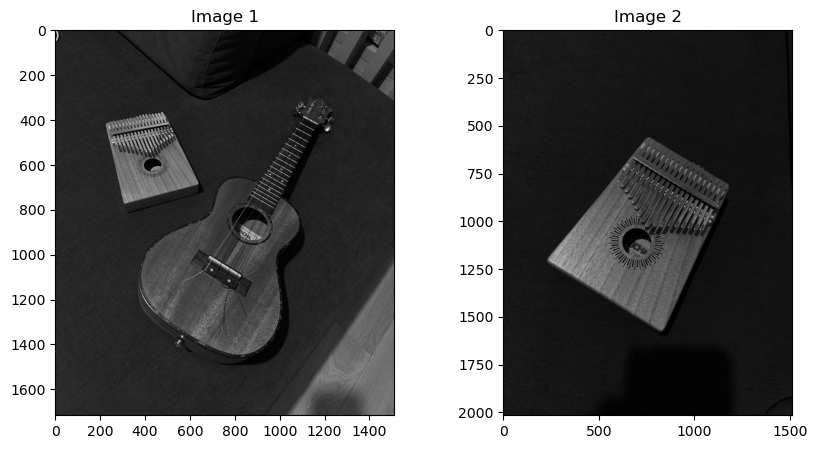

In [5]:
# # Load the images
# img1 = color.rgb2gray(plt.imread('_data/eifel_1.jpeg')[:700, 300:700])
# img2 = color.rgb2gray(plt.imread('_data/eifel_2.jpeg'))

img1 = color.rgb2gray(plt.imread('_data/inst_1.png'))
img2 = color.rgb2gray(plt.imread('_data/inst_2.png'))
img1 = transform.rescale(img1, 0.5)[300:,:]
img2 = transform.rescale(img2, 0.5)
# Display the images
plt.figure(figsize=(10, 5))

# Plot the first image
plt.subplot(1, 2, 1)
plt.imshow(img1, cmap="gray")
plt.title('Image 1')

# Plot the second image
plt.subplot(1, 2, 2)
plt.imshow(img2, cmap="gray")
plt.title('Image 2')

plt.show()

In [6]:
from sift import Sift
sift_1 = Sift(img1)
sift_2 = Sift(img2)

In [7]:
sift_1.octave_processing(image=sift_1.image, octave_scale_multiplier=2, sigmas=sift_1.sigmas_array, visualization=False)
sift_1.octave_processing(image=sift_1.image, octave_scale_multiplier=1, sigmas=sift_1.sigmas_array, visualization=False)
sift_1.octave_processing(image=sift_1.image, octave_scale_multiplier=0.5, sigmas=sift_1.sigmas_array, visualization=False)
# sift_1.octave_processing(image=sift_1.image, octave_scale_multiplier=0.25, sigmas=sift_1.sigmas_array, visualization=False)

Number of keypoints candidates: 9124
Number of keypoints candidates: 4984
Number of keypoints candidates: 7212


In [8]:
sift_2.octave_processing(image=sift_2.image, octave_scale_multiplier=2, sigmas=sift_1.sigmas_array, visualization=False)
sift_2.octave_processing(image=sift_2.image, octave_scale_multiplier=1, sigmas=sift_1.sigmas_array, visualization=False)
sift_2.octave_processing(image=sift_2.image, octave_scale_multiplier=0.5, sigmas=sift_1.sigmas_array, visualization=False)
# sift_2.octave_processing(image=sift_2.image, octave_scale_multiplier=0.25, sigmas=sift_1.sigmas_array, visualization=False)

Number of keypoints candidates: 14794
Number of keypoints candidates: 7129
Number of keypoints candidates: 8592


/Users/hlibokymaros/Documents/KKUI/Advanced-computer-vision/sift.py:193: RuntimeWarning: divide by zero encountered in divide
  principal_curv_ratio = trace_h**2 / det_h


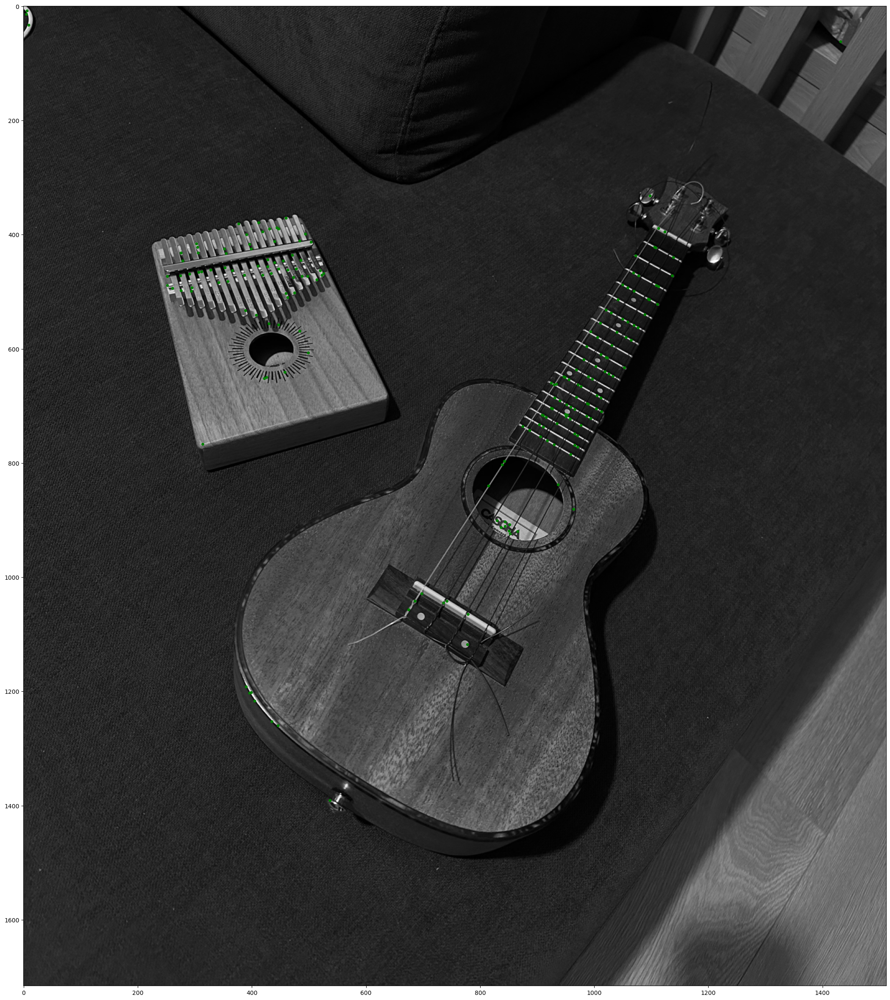

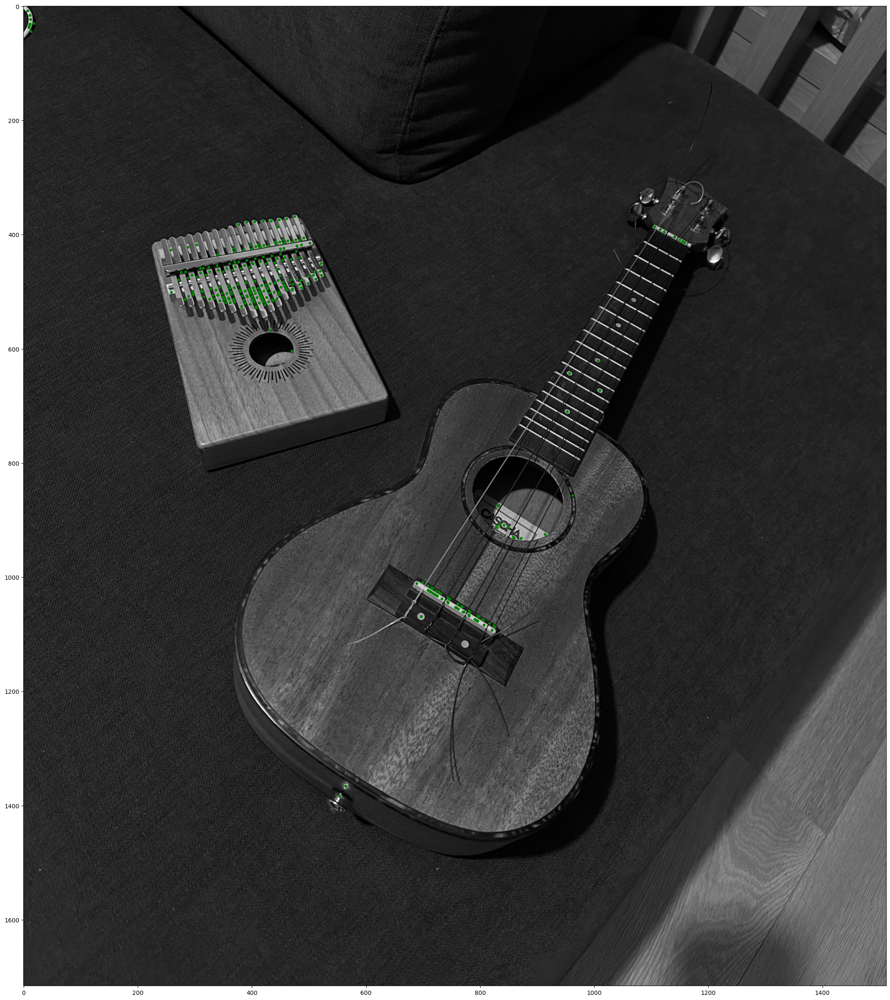

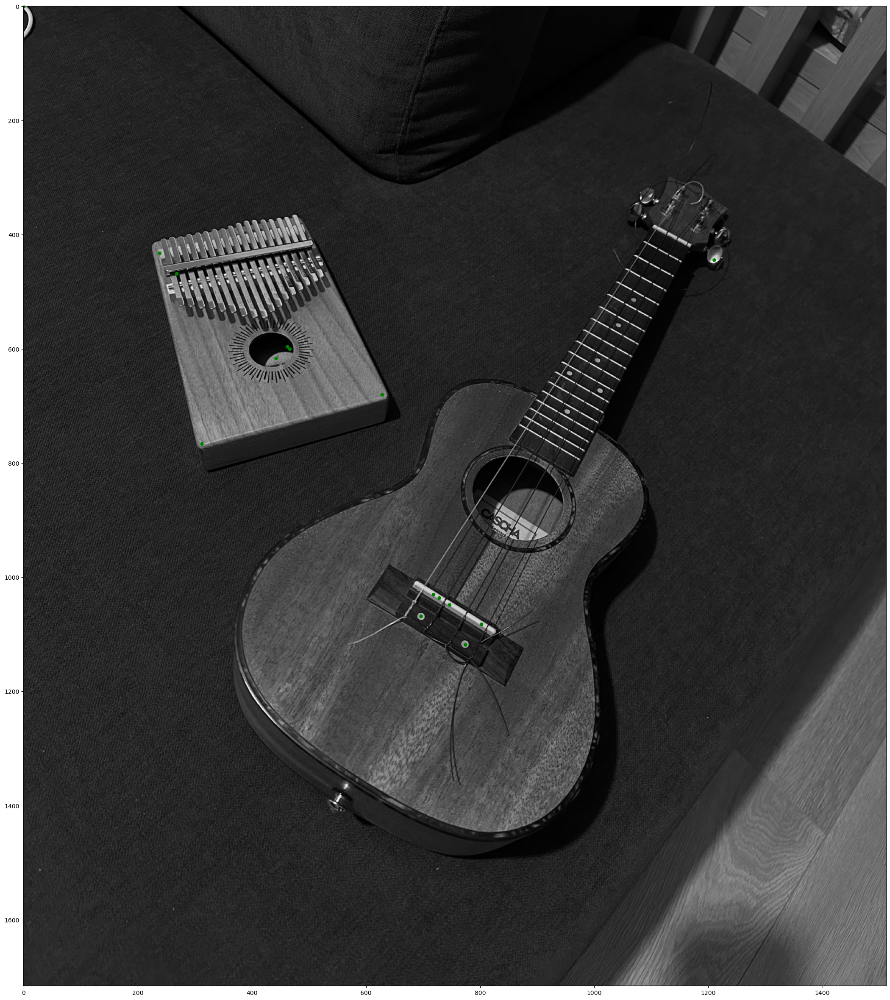

In [9]:
# Filtering
keypoints_1_0 = sift_1.filter_keypoints_in_octave(octave_index=0)
keypoints_1_1 = sift_1.filter_keypoints_in_octave(octave_index=1)
keypoints_1_2 = sift_1.filter_keypoints_in_octave(octave_index=2)
# keypoints_4_0 = sift_1.filter_keypoints_in_octave(octave_index=3)
# keypoints_2_0 = sift_2.filter_keypoints_in_octave(0)



/Users/hlibokymaros/Documents/KKUI/Advanced-computer-vision/sift.py:193: RuntimeWarning: invalid value encountered in divide
  principal_curv_ratio = trace_h**2 / det_h


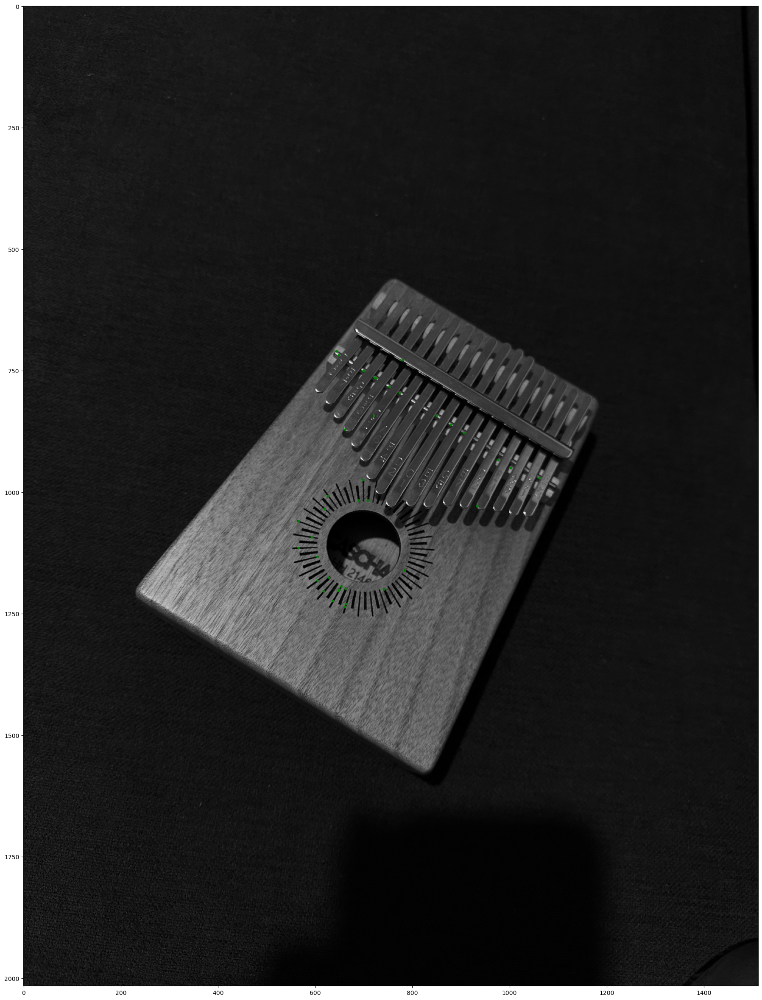

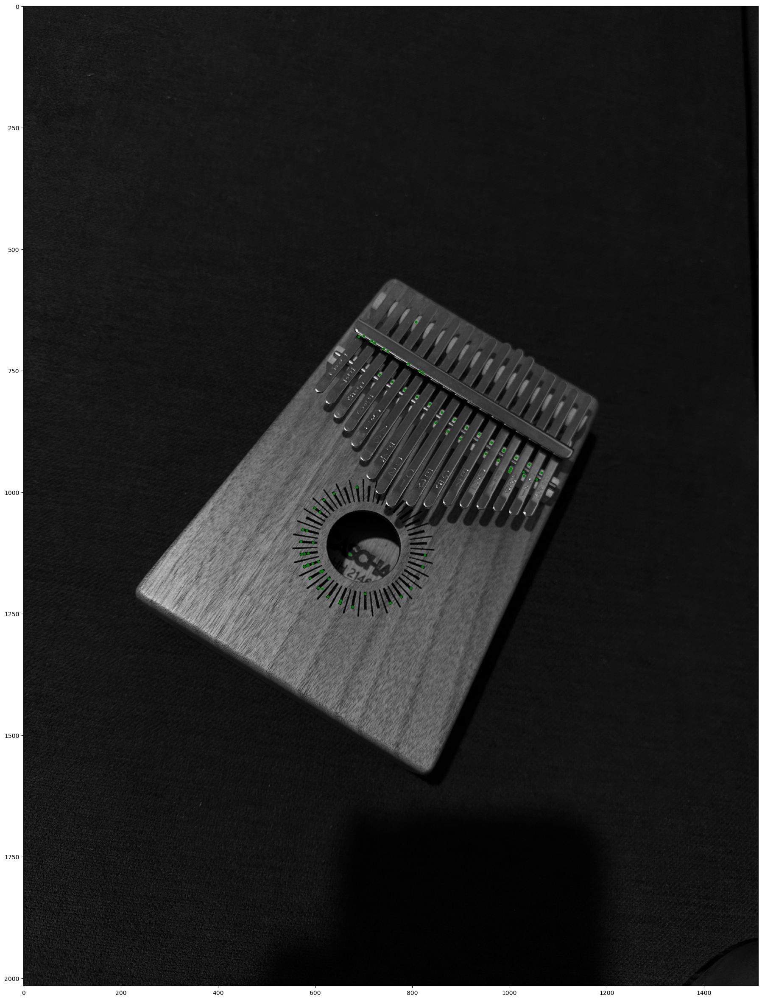

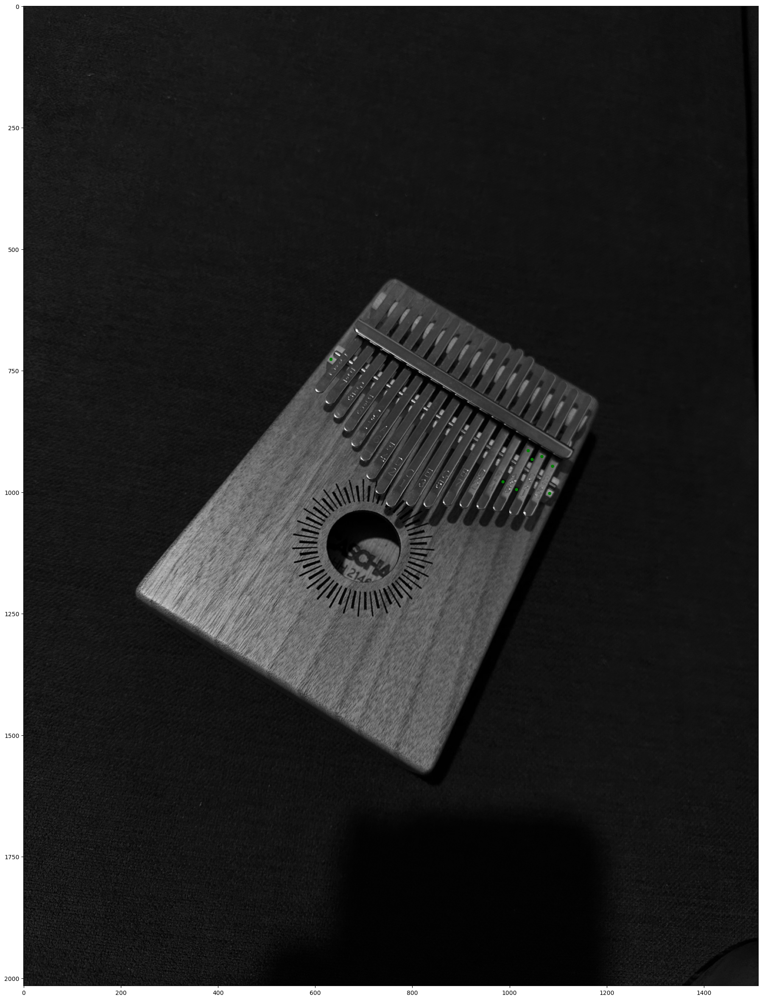

In [10]:
# Filtering
keypoints_2_0 = sift_2.filter_keypoints_in_octave(octave_index=0)
keypoints_2_1 = sift_2.filter_keypoints_in_octave(octave_index=1)
keypoints_2_2 = sift_2.filter_keypoints_in_octave(octave_index=2)
# keypoints_4_0 = sift_1.filter_keypoints_in_octave(octave_index=3)
# keypoints_2_0 = sift_2.filter_keypoints_in_octave(0)

In [11]:
keypoints_1 = keypoints_1_0 + keypoints_1_1 + keypoints_1_2
keypoints_2 = keypoints_2_0 + keypoints_2_1 + keypoints_2_2

# keypoints_1 = keypoints_1_0 * keypoints_1_1 * keypoints_1_2
# keypoints_2 = keypoints_2_0 * keypoints_2_1 * keypoints_2_2

# keypoints_1 = keypoints_1_0
# keypoints_2 = keypoints_2_0


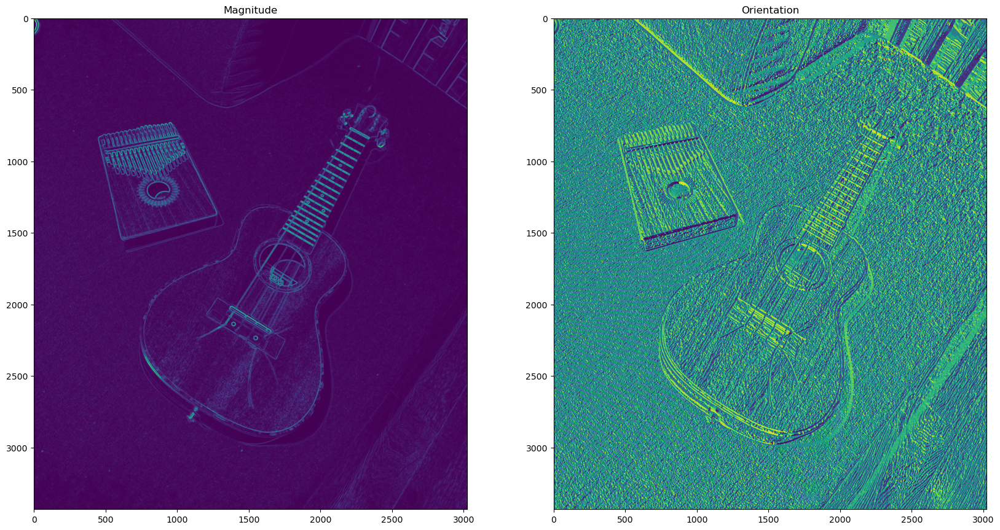

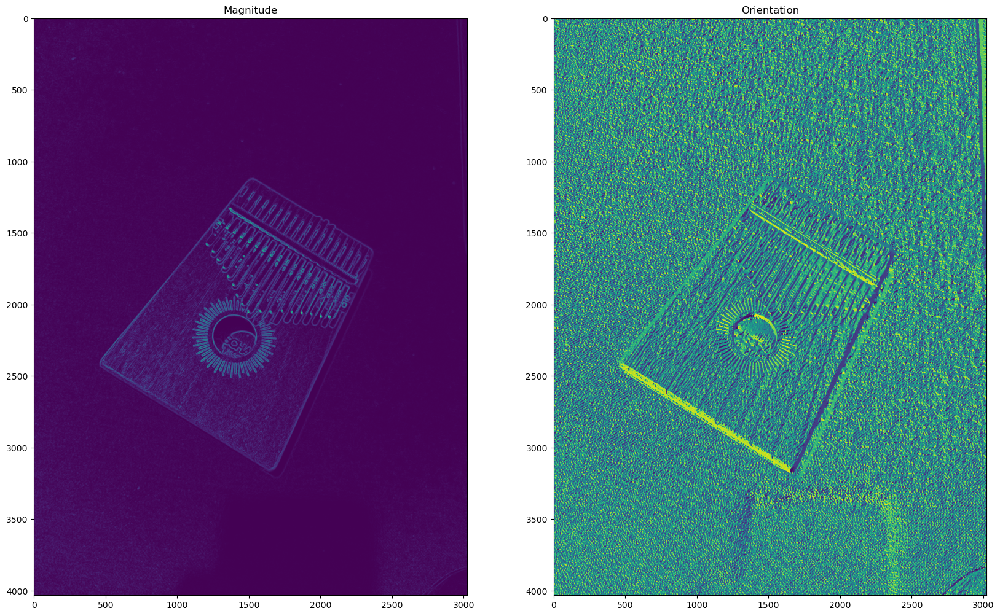

In [12]:
histrogram_array_1_0 = sift_1.get_keypoints_histgoram(keypoints_1)
histrogram_array_2_0 = sift_2.get_keypoints_histgoram(keypoints_2)

In [10]:
histrogram_array_1_0

NameError: name 'histrogram_array_1_0' is not defined

In [13]:
#feature matching
bf = cv2.BFMatcher(cv2.NORM_L1, crossCheck=True)

# bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
# # Convert arrays to compatible data types
# histrogram_array_1_0 = histrogram_array_1_0.astype(np.uint8)
# histrogram_array_2_0 = histrogram_array_2_0.astype(np.uint8)
# bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

matches = bf.match(histrogram_array_1_0,histrogram_array_2_0)
matches = sorted(matches, key = lambda x:x.distance)
len(matches)

44

In [14]:
matches

[< cv2.DMatch 0x17fee43d0>,
 < cv2.DMatch 0x17ff0a190>,
 < cv2.DMatch 0x17fee4e10>,
 < cv2.DMatch 0x17fee4a10>,
 < cv2.DMatch 0x17ff0a070>,
 < cv2.DMatch 0x17ff0a1f0>,
 < cv2.DMatch 0x17ff0a110>,
 < cv2.DMatch 0x16a632f10>,
 < cv2.DMatch 0x16a95c410>,
 < cv2.DMatch 0x17fee4550>,
 < cv2.DMatch 0x17fee4470>,
 < cv2.DMatch 0x17ff0a210>,
 < cv2.DMatch 0x17ff0a130>,
 < cv2.DMatch 0x17fee41d0>,
 < cv2.DMatch 0x17fee4650>,
 < cv2.DMatch 0x17fe57670>,
 < cv2.DMatch 0x17fee4a50>,
 < cv2.DMatch 0x17ff0a030>,
 < cv2.DMatch 0x17fee46f0>,
 < cv2.DMatch 0x16a9a34f0>,
 < cv2.DMatch 0x17ff0a170>,
 < cv2.DMatch 0x17ff0a0b0>,
 < cv2.DMatch 0x17fee44b0>,
 < cv2.DMatch 0x17fee41f0>,
 < cv2.DMatch 0x17ff0a230>,
 < cv2.DMatch 0x17ff0a090>,
 < cv2.DMatch 0x17fee4c70>,
 < cv2.DMatch 0x17fee4510>,
 < cv2.DMatch 0x16aaa8270>,
 < cv2.DMatch 0x17ff0a1b0>,
 < cv2.DMatch 0x17fe577d0>,
 < cv2.DMatch 0x17ff0a1d0>,
 < cv2.DMatch 0x17ff0a0d0>,
 < cv2.DMatch 0x17fee4cf0>,
 < cv2.DMatch 0x17ff0a0f0>,
 < cv2.DMatch 0x17ff

In [15]:
histrogram_array_1_0

array([[0.        , 0.        , 0.00726594, ..., 0.        , 0.00067394,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.12904768, 0.0365737 ,
        0.01186371],
       [0.        , 0.        , 0.        , ..., 0.05324401, 0.00551324,
        0.        ],
       ...,
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.00429318, 0.00487124, 0.        , ..., 0.        , 0.        ,
        0.        ]], dtype=float32)

In [16]:
# # Extract coordinates from your keypoints
# keypoints_1_coords = np.array([kp.pt for kp in keypoints_1])
# keypoints_2_coords = np.array([kp.pt for kp in keypoints_2])

# Convert coordinates to cv2.KeyPoint format
cv_keypoints_1 = [cv2.KeyPoint(int(x[1]), int(x[0]), 1) for x in np.array(np.where(keypoints_1)).T]
cv_keypoints_2 = [cv2.KeyPoint(int(x[1]), int(x[0]), 1) for x in np.array(np.where(keypoints_2)).T]

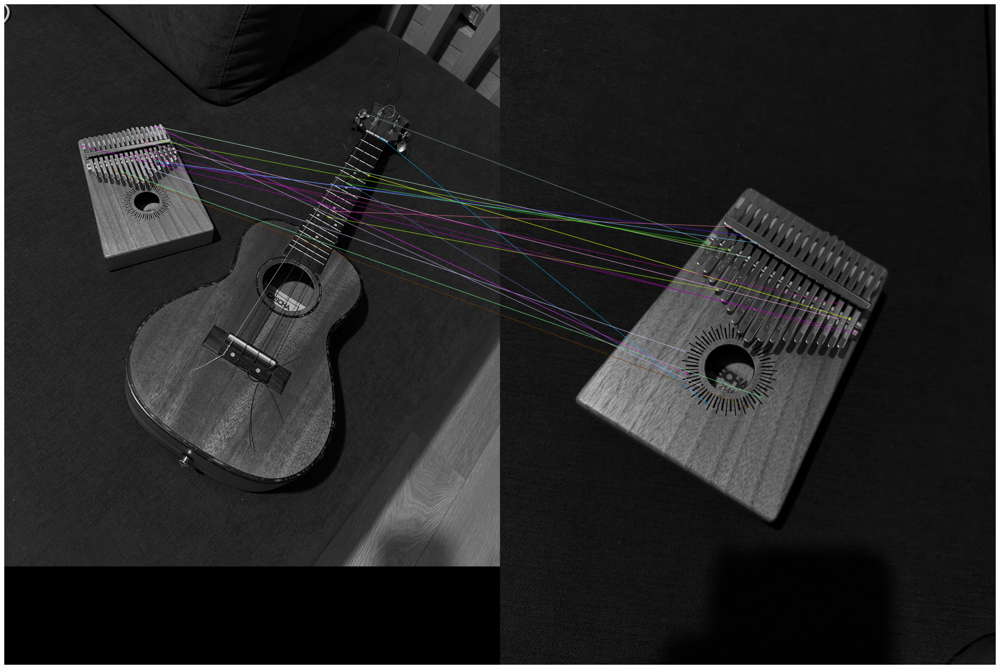

In [17]:
# # Convert coordinates to cv2.KeyPoint format
# cv_keypoints_1 = [cv2.KeyPoint(x, y, 1) for x, y in keypoints_1_coords]
# cv_keypoints_2 = [cv2.KeyPoint(x, y, 1) for x, y in keypoints_2_coords]
#
# # Draw matches

# Convert images to supported types (e.g., CV_8UC1)
img1_uint8 = (img1 * 255).astype(np.uint8)
img2_uint8 = (img2 * 255).astype(np.uint8)

# Convert grayscale images to BGR
img1_rgb = cv2.cvtColor(img1_uint8, cv2.COLOR_GRAY2BGR)
img2_rgb = cv2.cvtColor(img2_uint8, cv2.COLOR_GRAY2BGR)


# Draw matches
img3 = cv2.drawMatches(img1_rgb, cv_keypoints_1, img2_rgb, cv_keypoints_2, matches[:20], img2_rgb, flags=2)

# Plot the result
plt.figure(figsize=(30, 30))
plt.imshow(img3)
plt.axis('off')
plt.show()

In [18]:
bf = cv2.BFMatcher_create()
matches = bf.knnMatch(histrogram_array_1_0, histrogram_array_2_0,k=2)

In [19]:
good_matches = []

for m1, m2 in matches:
    if m1.distance < 0.6*m2.distance:
        good_matches.append(m1)

In [20]:
len(good_matches)

4

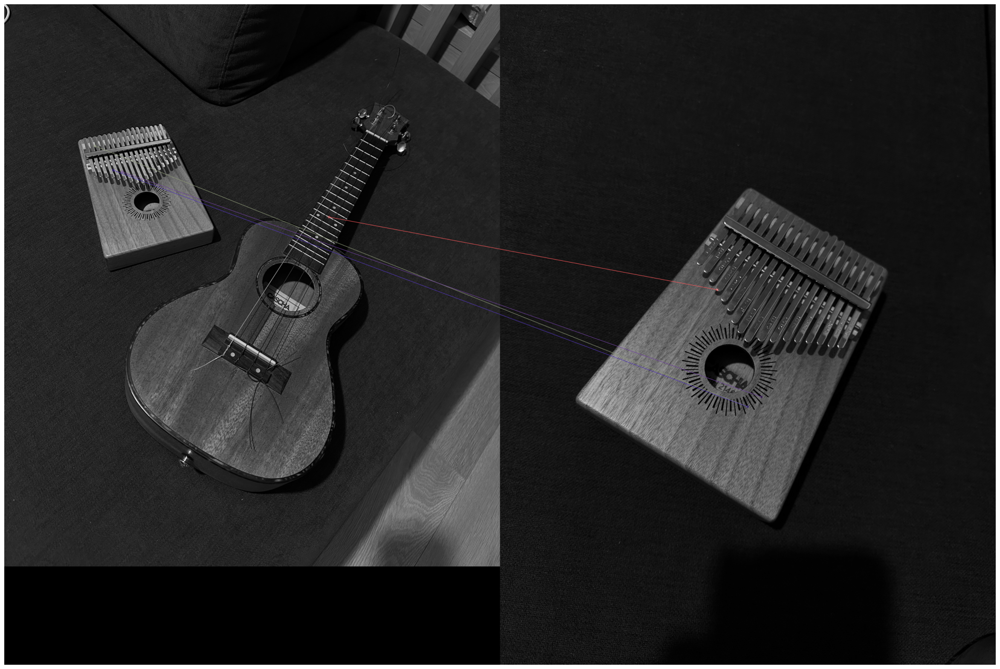

In [21]:
# Draw matches
img3 = cv2.drawMatches(img1_rgb, cv_keypoints_1, img2_rgb, cv_keypoints_2, good_matches, None, flags=2)

# Plot the result
plt.figure(figsize=(30, 30))
plt.imshow(img3)
plt.axis('off')
plt.show()

[ WARN:0@267.281] global shadow_sift.hpp:15 SIFT_create DEPRECATED: cv.xfeatures2d.SIFT_create() is deprecated due SIFT tranfer to the main repository. https://github.com/opencv/opencv/issues/16736


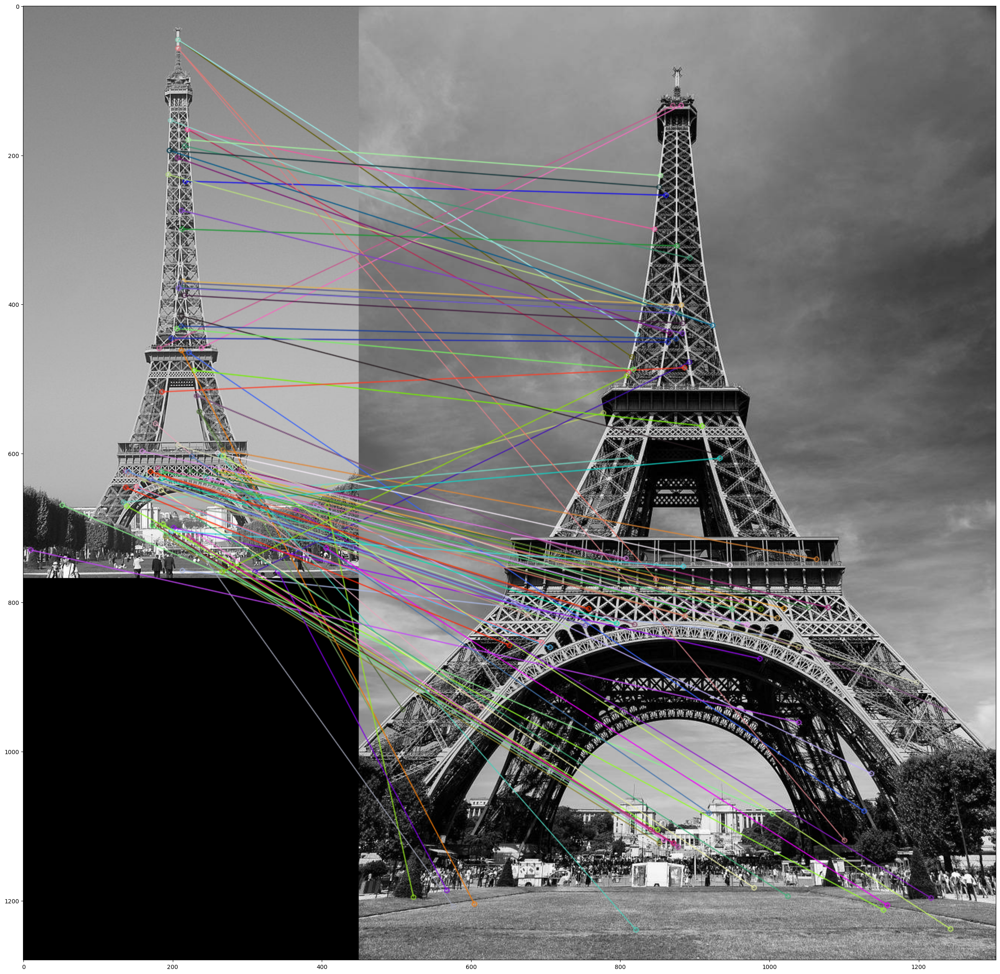

In [22]:
import cv2
import matplotlib.pyplot as plt
%matplotlib inline

# read images
img1 = cv2.imread('_data/eifel_1.jpeg')[:,300:750]
img2 = cv2.imread('_data/eifel_2.jpeg')

img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

#sift
sift = cv2.xfeatures2d.SIFT_create()

keypoints_1, descriptors_1 = sift.detectAndCompute(img1,None)
keypoints_2, descriptors_2 = sift.detectAndCompute(img2,None)

#feature matching
bf = cv2.BFMatcher(cv2.NORM_L1, crossCheck=True)

matches = bf.match(descriptors_1,descriptors_2)
matches = sorted(matches, key = lambda x:x.distance)

img3 = cv2.drawMatches(img1, keypoints_1, img2, keypoints_2, matches[:100], img2, flags=2)
plt.figure(figsize=(30,30))
plt.imshow(img3)
plt.show()

In [ ]:
!pip install opencv-contrib-python

In [23]:
len(keypoints_1)

1099

In [24]:
type(descriptors_1[0,0])

numpy.float32

In [25]:
#feature matching
bf = cv2.BFMatcher(cv2.NORM_L1, crossCheck=True)

matches = bf.match(descriptors_1[:,:20],descriptors_2[:,:20])

In [26]:
len(descriptors_2)

5888

In [27]:
matches[0]

< cv2.DMatch 0x16a616810>

In [28]:
matches = bf.knnMatch (descriptors_1, descriptors_2,k=2)

error: OpenCV(4.9.0) /Users/xperience/GHA-OpenCV-Python2/_work/opencv-python/opencv-python/opencv/modules/core/src/batch_distance.cpp:303: error: (-215:Assertion failed) K == 1 && update == 0 && mask.empty() in function 'batchDistance'


In [29]:
import numpy as np
img1_gray = img1
img2_gray = img2

In [30]:
# Create our ORB detector and detect keypoints and descriptors
orb = cv2.ORB_create()

In [ ]:
# Find keypoints and descriptors with ORB
keypoints1, descriptors1 = orb.detectAndCompute(img1, None)
keypoints2, descriptors2 = orb.detectAndCompute(img2, None)

In [ ]:
# Create a BFMatcher object.
# It will find all of the matching keypoints on two images
bf = cv2.BFMatcher_create(cv2.NORM_HAMMING,crossCheck=True)

In [ ]:
matches = bf.match(descriptors1, descriptors2)

In [ ]:
matches = sorted(matches,key=lambda x:x.distance)

In [ ]:
ORB_matches =cv2.drawMatches(img1, keypoints1, img2, keypoints2, matches[:30], None, flags=2)
# Draw matches
# img3 = cv2.drawMatches(img1_rgb, cv_keypoints_1, img2_rgb, cv_keypoints_2, matches[:20], img2_rgb, flags=2)

# Plot the result
plt.figure(figsize=(30, 30))
plt.imshow(ORB_matches)
plt.axis('off')
plt.show()

In [ ]:
bf = cv2.BFMatcher_create()
matches = bf.knnMatch(descriptors1, descriptors2,k=2)

In [ ]:
matches